In [2]:
# TODO: Make all necessary imports.
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import os
import glob
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import warnings
warnings.filterwarnings('ignore')

import logging
logger = tf.get_logger()
logger.setLevel(logging.ERROR)


In [3]:
print(tf.__version__)

2.4.1


In [4]:
def get_files(base_dir, target_dir):
    count = 0
    path = get_path(base_dir, target_dir)
    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            count+=len(glob.glob(os.path.join(dirname, filename)))
        return path, count
    
def get_path(base_dir, target_dir):
    path = os.path.join(base_dir,target_dir)
    return path

In [5]:
base_dir = '/kaggle/input/cassava-leaf-disease-classification'
train_dir = 'train_images'
labels_file = 'train.csv'
test_dir = 'test_images'
json_file = 'label_num_to_disease_map.json'

train_path, train_count = get_files(base_dir,train_dir)
test_path, test_count = get_files(base_dir,test_dir)

with open(get_path(base_dir,json_file)) as f:
    class_names = json.load(f)
    class_dict = pd.Series(class_names.values()).to_dict()
    f.close()

data = pd.read_csv(get_path(base_dir, labels_file))
data['class_name'] = data.label.map(class_dict)

print("No of Train Images: {}".format(train_count))
print("No of Test Images: {}".format(test_count))
print("No of Classes: {}".format(len(class_dict)))
print("Classes:")
for v in class_dict.values():
    print(" \u2022 {}".format(v))

No of Train Images: 21397
No of Test Images: 1
No of Classes: 5
Classes:
 • Cassava Bacterial Blight (CBB)
 • Cassava Brown Streak Disease (CBSD)
 • Cassava Green Mottle (CGM)
 • Cassava Mosaic Disease (CMD)
 • Healthy


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21397 entries, 0 to 21396
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_id    21397 non-null  object
 1   label       21397 non-null  int64 
 2   class_name  21397 non-null  object
dtypes: int64(1), object(2)
memory usage: 501.6+ KB


<AxesSubplot:>

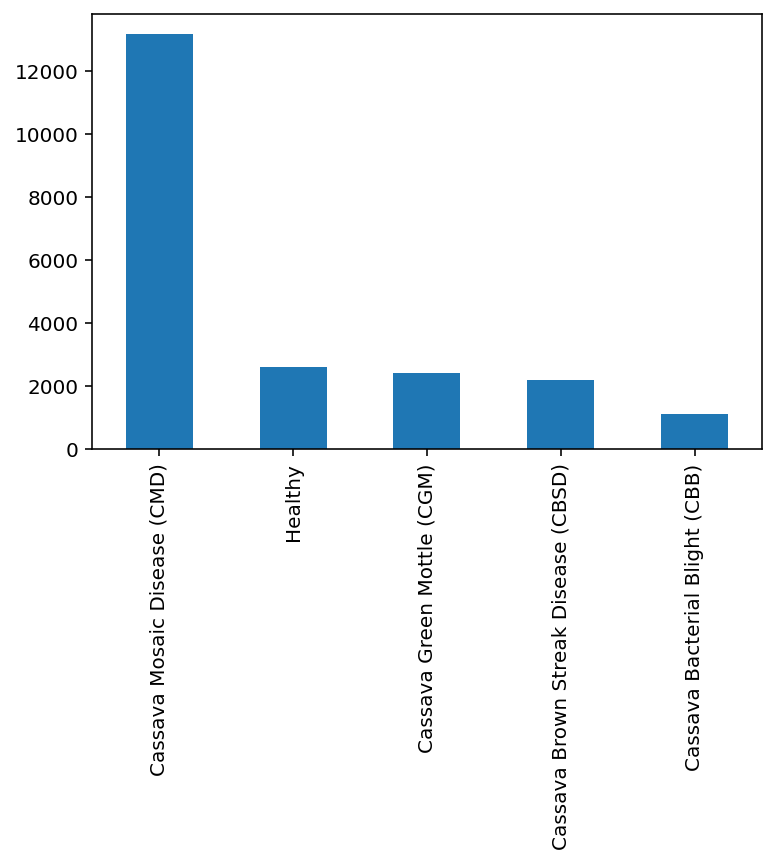

In [7]:
data['class_name'].value_counts().plot(kind='bar')

In [8]:
image = cv2.imread(os.path.join(train_path, "6103.jpg"))
image.shape

(600, 800, 3)

In [9]:
for dirname, _, filenames in os.walk(train_path):
    for filename in filenames:
        image = cv2.imread(os.path.join(train_path, filename))
        image_size = image.shape
        break

image_size

(600, 800, 3)

Found 21397 validated image filenames belonging to 5 classes.


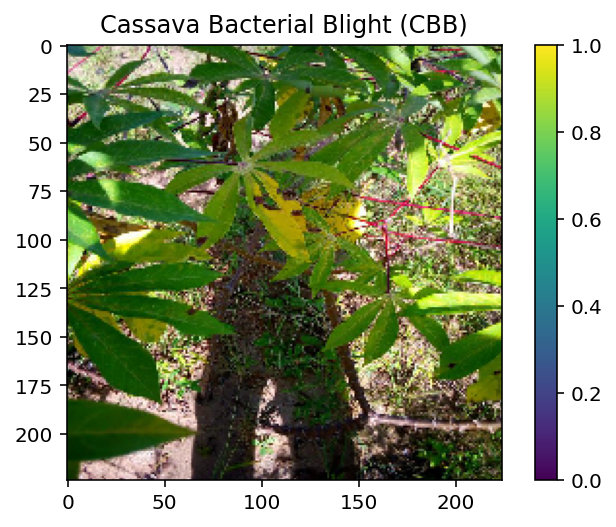

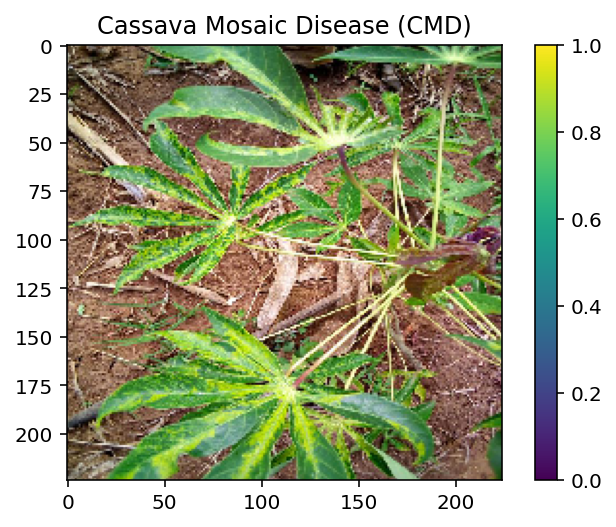

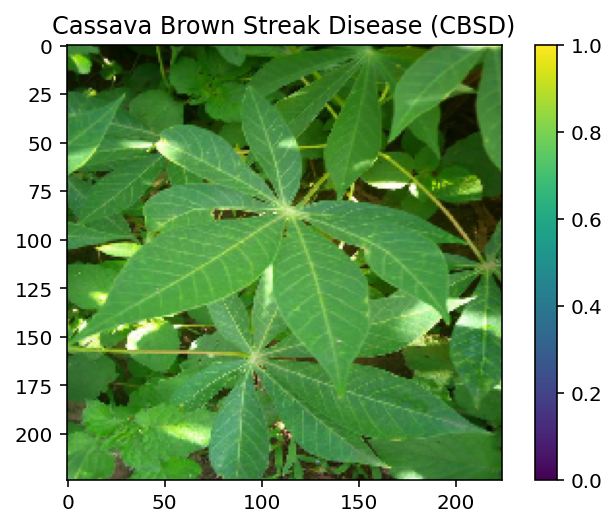

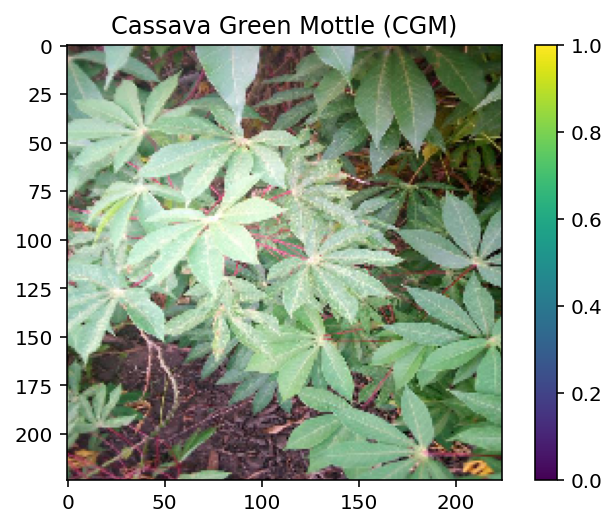

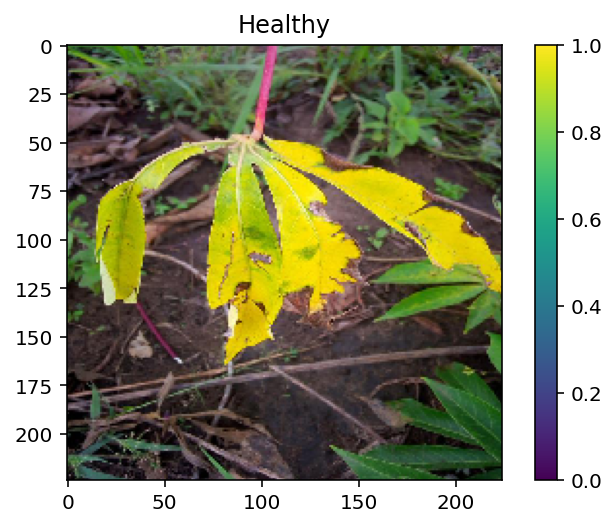

In [10]:
BATCH_SIZE = 64
IMG_SHAPE  = 224

train_image_gen = ImageDataGenerator(rescale=1./255)

one_image = train_image_gen.flow_from_dataframe(data,
                                          directory=train_path,
                                          x_col='image_id',
                                          y_col='class_name',
                                          class_mode='categorical',
                                          batch_size=BATCH_SIZE,
                                          shuffle=False,
                                          target_size=(IMG_SHAPE,IMG_SHAPE))

a=[]
for i,v in enumerate(one_image.classes):
    if v not in a and len(a)<5:
            a.append(v)
            plt.imshow(one_image[0][0][i])
            plt.title(class_dict[one_image.classes[i]])
            plt.colorbar()
            plt.show()

<Figure size 1080x1080 with 0 Axes>

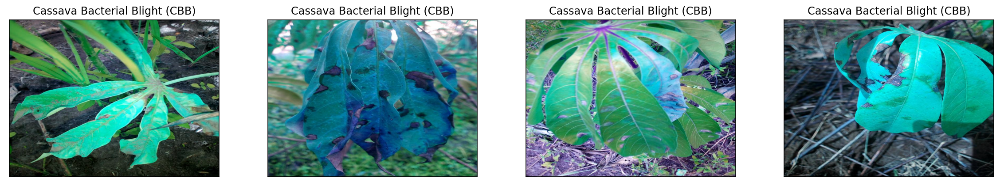

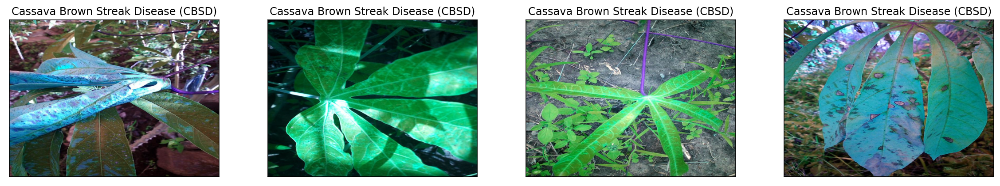

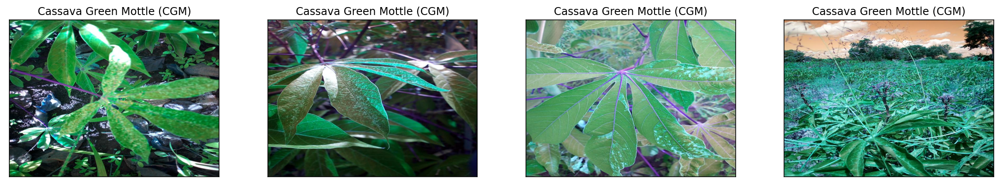

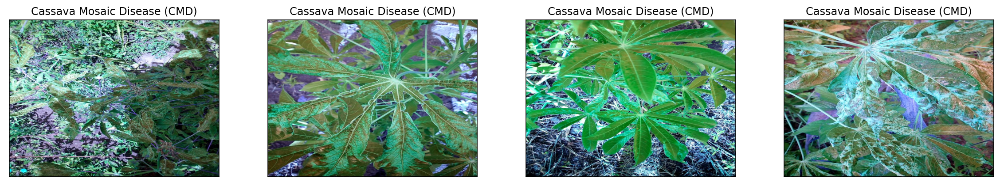

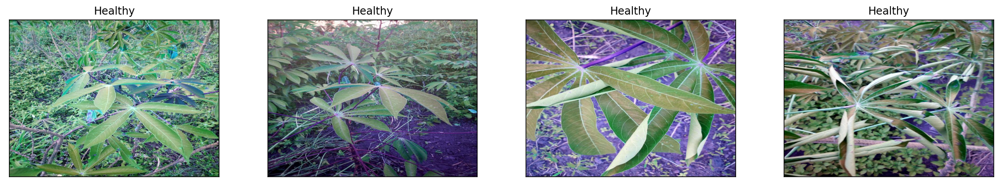

In [12]:
def visualize_img(images):
    fig = plt.figure(figsize=(20, 15))
    for i,a in enumerate(images):
        fig.add_subplot(4, 4, i+1, xticks=[], yticks=[])
        path = get_path(train_path, a)
        img = cv2.imread(path)
        plt.imshow(img)
        plt.title(data[data.image_id == a].class_name.values[0])
    
fig = plt.figure(figsize=(15, 15))
p=0
for i in range(5):
    images = data[data.label == i].image_id
    images = np.random.choice(images , 4)
    visualize_img(images)

In [13]:
# This function will plot images in the form of a grid with 1 row and 5 columns
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip(images_arr, axes):
        ax.imshow(img)
    plt.tight_layout()
    plt.show()

In [14]:
BATCH_SIZE = 32
IMG_SHAPE  = 224

train_image_gen = ImageDataGenerator(rescale=1./255,
                                     width_shift_range=0.1,
                                     height_shift_range=0.1,
                                     brightness_range = [2.0, 1.0],
                                     zoom_range=0.2,
                                     horizontal_flip=True,
                                     vertical_flip=True,
                                     fill_mode='nearest')

train_gen = train_image_gen.flow_from_dataframe(data,
                                          directory=train_path,
                                          x_col='image_id',
                                          y_col='class_name',
                                          class_mode='categorical',
                                          batch_size=BATCH_SIZE,
                                          shuffle=True,
                                          target_size=(IMG_SHAPE,IMG_SHAPE))

Found 21397 validated image filenames belonging to 5 classes.


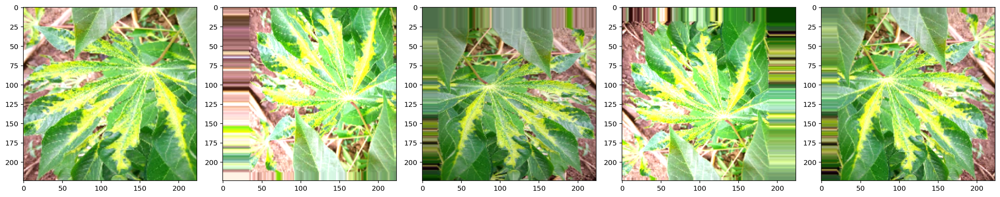

In [17]:
augmented_images = [train_gen[0][0][2] for i in range(5)]
plotImages(augmented_images)

## Data Preprocessing

In [6]:
from sklearn.model_selection import train_test_split
train, val = train_test_split(data, test_size = 0.2, stratify=data['class_name'], random_state=42)

print("Training set has {} samples".format(train.shape[0]))
print("Validation set has {} samples".format(val.shape[0]))

Training set has 17117 samples
Validation set has 4280 samples


In [7]:
train.label = train.label.astype('str')
val.label = val.label.astype('str')

In [8]:
BATCH_SIZE = 32
IMG_SHAPE  = 224
EPOCHS = 30

def gen():
    train_image_gen = ImageDataGenerator(rescale=1./255,
                                         width_shift_range=0.1,
                                         height_shift_range=0.1,
                                         zoom_range=0.2,
                                         brightness_range=[0.2,1.0],
                                         horizontal_flip=True,
                                         vertical_flip=True,
                                         fill_mode='nearest')

    train_gen = train_image_gen.flow_from_dataframe(train,
                                              directory=train_path,
                                              x_col='image_id',
                                              y_col='label',
                                              class_mode='sparse',
                                              batch_size=BATCH_SIZE,
                                              shuffle=True,
                                              target_size=(IMG_SHAPE,IMG_SHAPE))


    val_image_gen = ImageDataGenerator(rescale=1./255)

    val_gen = val_image_gen.flow_from_dataframe(val,
                                              directory=train_path,
                                              x_col='image_id',
                                              y_col='label',
                                              class_mode='sparse',
                                              batch_size=BATCH_SIZE,
                                              target_size=(IMG_SHAPE,IMG_SHAPE))
    return train_gen, val_gen



In [9]:
def plot(history):

    training_accuracy = history.history['accuracy']
    validation_accuracy = history.history['val_accuracy']

    training_loss = history.history['loss']
    validation_loss = history.history['val_loss']

    epochs_range=range(len(training_accuracy))

    plt.figure(figsize=(8, 8))
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, training_accuracy, label='Training Accuracy')
    plt.plot(epochs_range, validation_accuracy, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')

    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, training_loss, label='Training Loss')
    plt.plot(epochs_range, validation_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')
    plt.show()

In [10]:
from PIL import Image
def predict(image_path, model):
    im = Image.open(image_path)
    test_image = np.asarray(im)
    processed_test_image = process_image(test_image)
    processed_test_image = np.expand_dims(processed_test_image, axis = 0)
    
    ps = model.predict(processed_test_image)
    return ps
    
def process_image(image):
    image = tf.cast(image , tf.float32)
    image = tf.image.resize(image , (224 , 224))
    image = image/255
    image = image.numpy()
    return image

In [24]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization, GlobalAveragePooling2D

model = Sequential()
model.add(Conv2D(filters=16, kernel_size=2, padding='same', activation='relu', input_shape=(224, 224, 3)))
model.add(Conv2D(filters=16, kernel_size=2, padding='same', activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2, strides=2))
model.add(Dropout(0.2))

model.add(Conv2D(filters=32, kernel_size=2, padding='same', activation='relu'))
model.add(Conv2D(filters=32, kernel_size=2, padding='same', activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2, strides=2))
model.add(Dropout(0.2))

model.add(Conv2D(filters=64, kernel_size=2, padding='same', activation='relu'))
model.add(Conv2D(filters=64, kernel_size=2, padding='same', activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2, strides=2))
model.add(Dropout(0.2))

model.add(Conv2D(filters=128, kernel_size=2, padding='same', activation='relu'))
model.add(Conv2D(filters=128, kernel_size=2, padding='same', activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2, strides=2))
model.add(Dropout(0.2))

model.add(GlobalAveragePooling2D())
model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(32, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(5, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 16)      208       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 16)      1040      
_________________________________________________________________
batch_normalization (BatchNo (None, 224, 224, 16)      64        
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 16)      0         
_________________________________________________________________
dropout (Dropout)            (None, 112, 112, 16)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 112, 32)      2080      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 112, 112, 32)      4

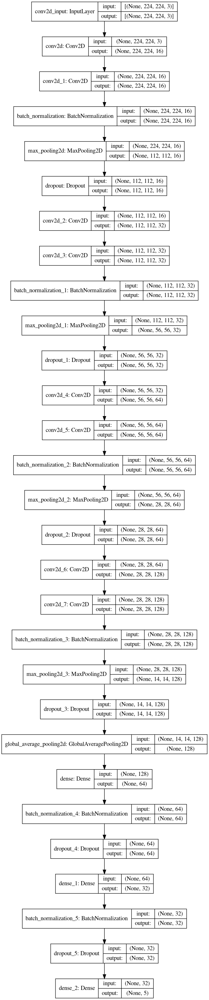

In [25]:
from keras.utils.vis_utils import plot_model
plot_model(model, to_file='scratch_model.png', show_shapes=True, show_layer_names=True)

In [26]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

train_gen, val_gen = gen()
optm = tf.keras.optimizers.Adam(lr=0.001)
model.compile(loss='sparse_categorical_crossentropy', optimizer=optm,
                  metrics=['accuracy'])
   

EarlyStopping = EarlyStopping(monitor='val_loss',
                              min_delta=.001,
                              patience=5,
                              verbose=1,
                              mode='auto',
                              baseline=None,
                              restore_best_weights=True)

model_save = ModelCheckpoint('./scratch_model.h5',
                             save_best_only = True, 
                             save_weights_only = False,
                             monitor = 'val_loss', 
                             mode = 'min', verbose = 1)

history = model.fit_generator(train_gen,
                              steps_per_epoch = train_gen.samples // BATCH_SIZE,
                              epochs = EPOCHS,
                              validation_data = val_gen,
                              validation_steps = val_gen.samples // BATCH_SIZE,
                              callbacks=[EarlyStopping, model_save])

Found 17117 validated image filenames belonging to 5 classes.
Found 4280 validated image filenames belonging to 5 classes.
Epoch 1/30
534/534 [==============================] - 490s 910ms/step - loss: 1.9674 - accuracy: 0.3162 - val_loss: 1.6217 - val_accuracy: 0.3705

Epoch 00001: val_loss improved from inf to 1.62172, saving model to ./scratch_model.h5
Epoch 2/30
534/534 [==============================] - 369s 691ms/step - loss: 1.2507 - accuracy: 0.5799 - val_loss: 1.1388 - val_accuracy: 0.6295

Epoch 00002: val_loss improved from 1.62172 to 1.13878, saving model to ./scratch_model.h5
Epoch 3/30
534/534 [==============================] - 373s 699ms/step - loss: 1.1143 - accuracy: 0.6168 - val_loss: 1.1313 - val_accuracy: 0.6198

Epoch 00003: val_loss improved from 1.13878 to 1.13130, saving model to ./scratch_model.h5
Epoch 4/30
534/534 [==============================] - 369s 692ms/step - loss: 1.0357 - accuracy: 0.6337 - val_loss: 0.9707 - val_accuracy: 0.6532

Epoch 00004: val_los

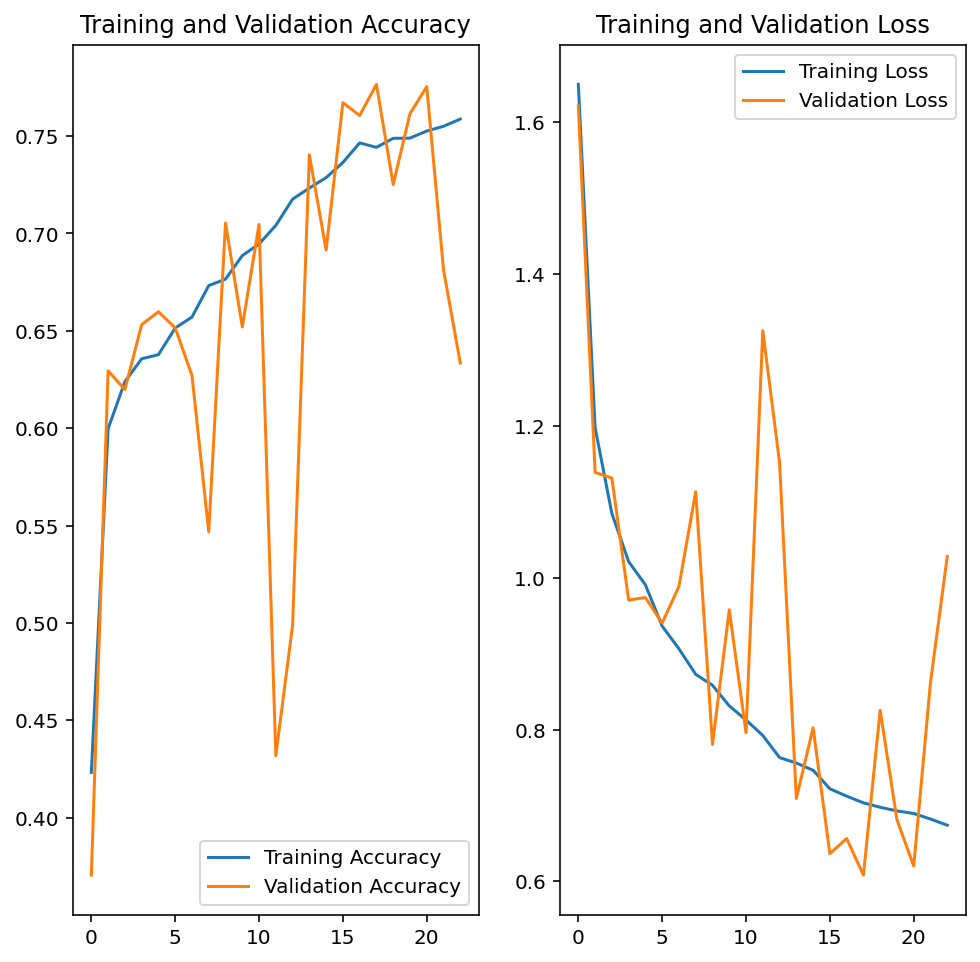

In [27]:
plot(history)

In [30]:
print(history.history["val_accuracy"][-6])
print(history.history["val_loss"][-6])

0.7765507698059082
0.6082602739334106


In [32]:
test_images = os.listdir(test_path)    
for image in test_images:
    print(np.argmax(predict(os.path.join(test_path, image) , model)))

3


In [46]:
def all_activations_vis(img, layers = 10):
    layer_outputs = [layer.output for layer in model.layers[:layers]]
    activation_model = tf.keras.models.Model(inputs = model.input, outputs = layer_outputs)
    img = np.expand_dims(img, axis = 0)
    activations = activation_model.predict(img)
    
    layer_names = []
    for layer in model.layers[:layers]: 
        layer_names.append(layer.name) 

    images_per_row = 3
    for layer_name, layer_activation in zip(layer_names, activations): 
        n_features = layer_activation.shape[-1] 

        size = layer_activation.shape[1] 

        n_cols = n_features // images_per_row 
        display_grid = np.zeros((size * n_cols, images_per_row * size)) 

        for col in range(n_cols): 
            for row in range(images_per_row): 
                channel_image = layer_activation[0, :, :, col * images_per_row + row] 
                channel_image -= channel_image.mean() 
                channel_image /= channel_image.std() 
                channel_image *= 64 
                channel_image += 128 
                channel_image = np.clip(channel_image, 0, 255).astype('uint8') 
                display_grid[col * size : (col + 1) * size, 
                             row * size : (row + 1) * size] = channel_image 
        scale = 1. / size 
        plt.figure(figsize=(scale * 5 * display_grid.shape[1], 
                            scale * 5 * display_grid.shape[0])) 
        plt.title(layer_name) 
        plt.grid(False)
        plt.axis('off')
        plt.imshow(display_grid, aspect = 'auto', cmap = 'viridis')

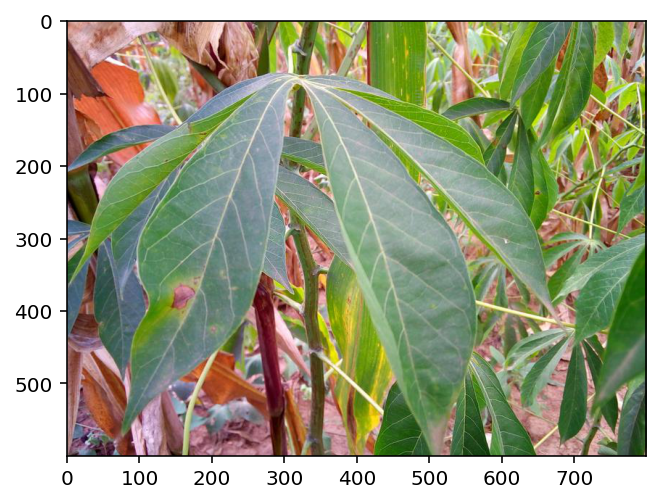

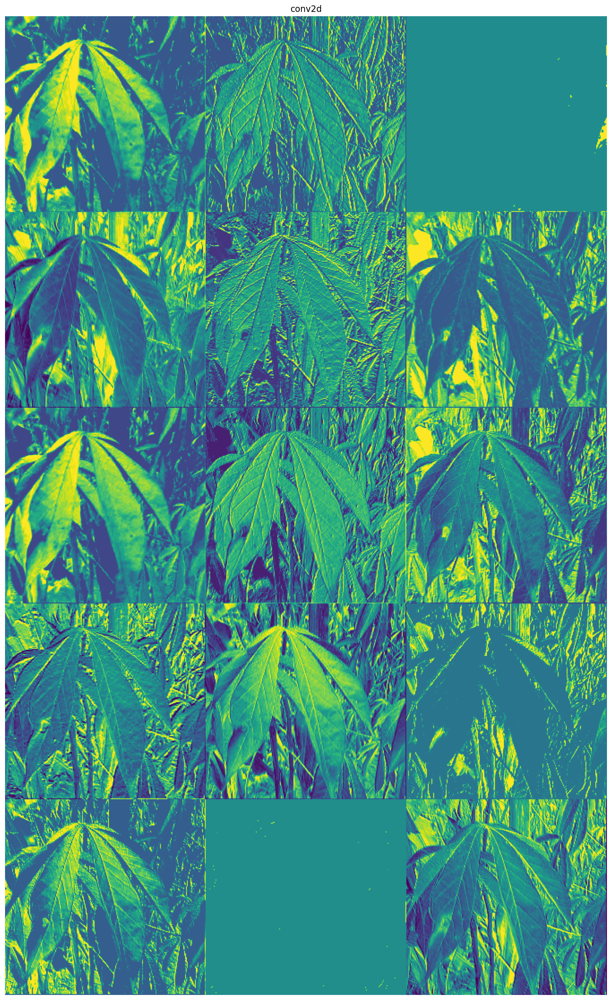

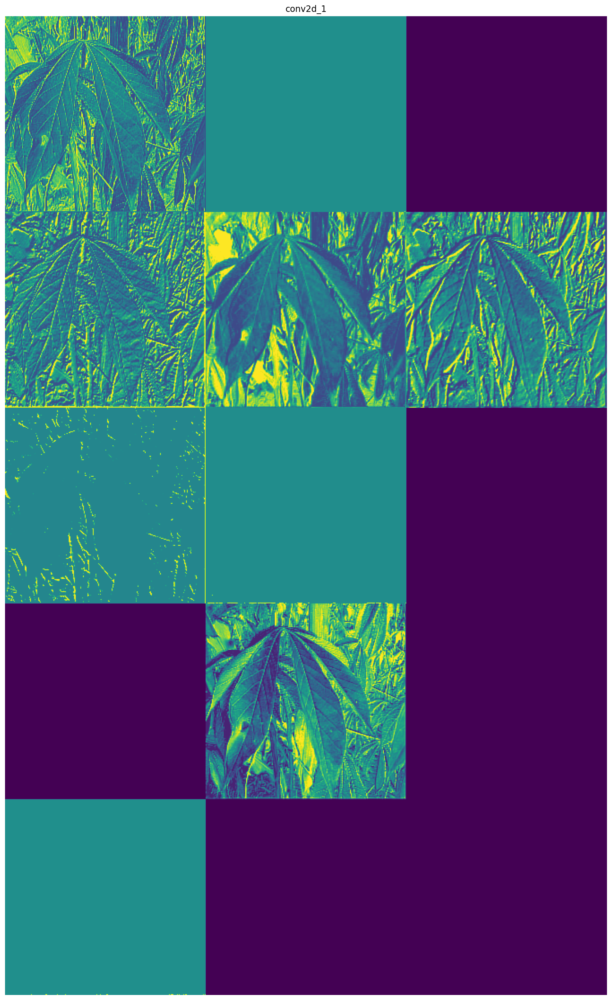

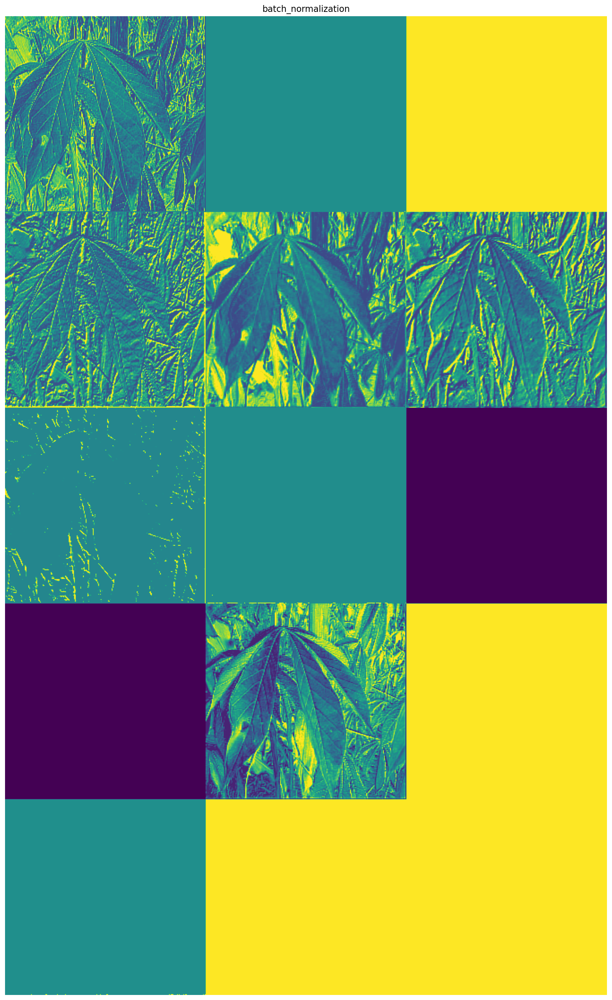

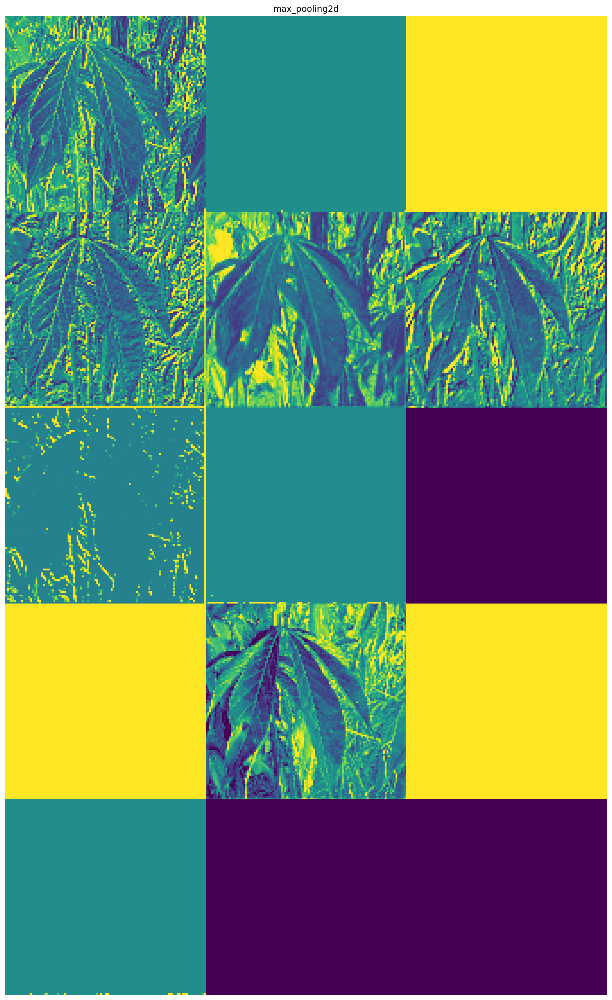

...

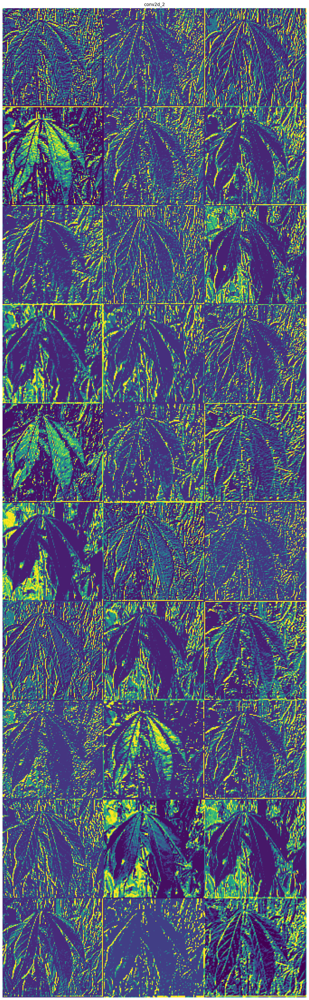

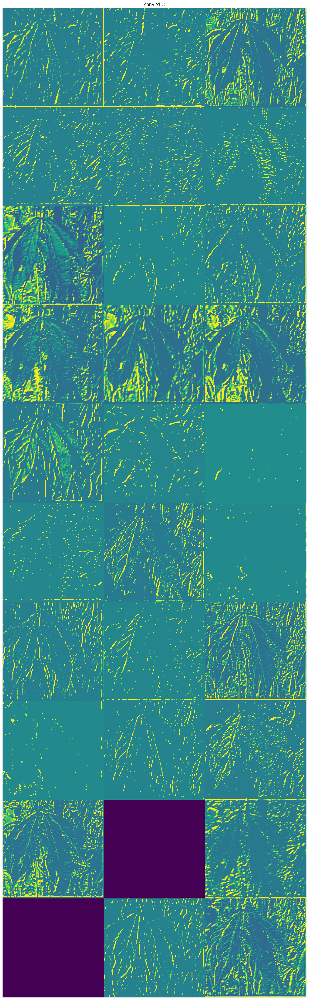

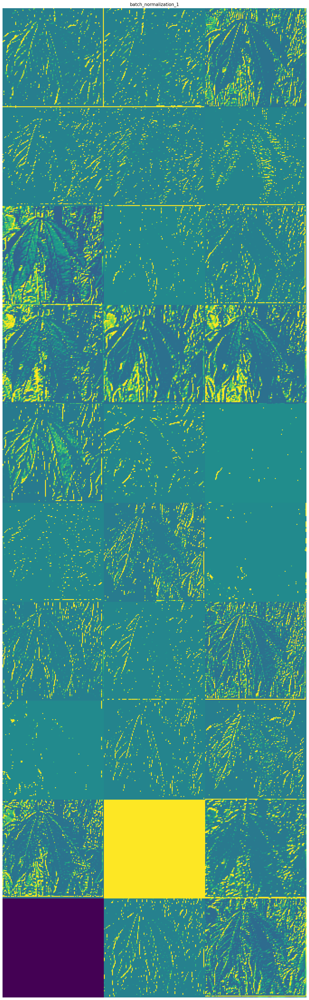

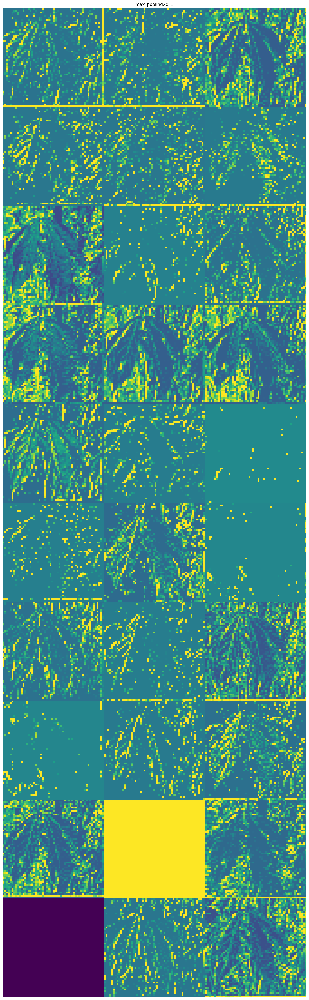

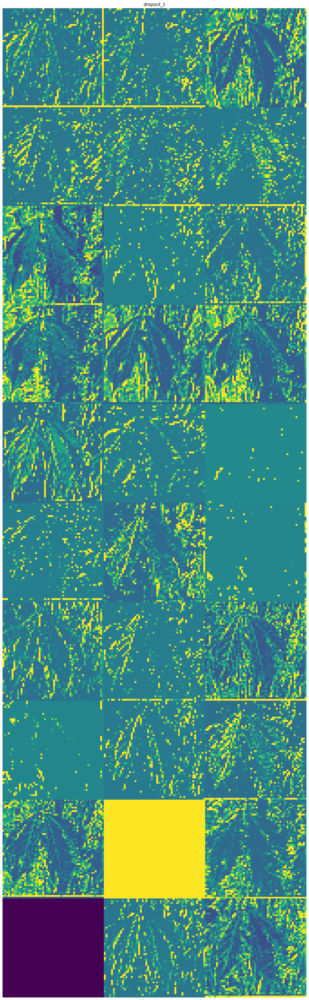

In [55]:
image = np.random.choice(train.image_id, 1)
image = np.asarray(Image.open(os.path.join(train_path,image[0])))
plt.imshow(image)
all_activations_vis(process_image(image), 10)

In [13]:
tf.keras.backend.clear_session()
model2 = Sequential()
model2.add(Conv2D(filters=16, kernel_size=3, padding='same', activation='relu', input_shape=(224, 224, 3)))
model2.add(BatchNormalization())
model2.add(Conv2D(filters=16, kernel_size=3, padding='same', activation='relu'))
model2.add(BatchNormalization())
model2.add(MaxPooling2D(pool_size=2, strides=2))
model2.add(Dropout(0.2))

model2.add(Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'))
model2.add(BatchNormalization())
model2.add(Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'))
model2.add(BatchNormalization())
model2.add(MaxPooling2D(pool_size=2, strides=2))
model2.add(Dropout(0.3))

model2.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
model2.add(BatchNormalization())
model2.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'))
model2.add(BatchNormalization())
model2.add(MaxPooling2D(pool_size=2, strides=2))
model2.add(Dropout(0.4))

model2.add(Conv2D(filters=128, kernel_size=3, padding='same', activation='relu'))
model2.add(BatchNormalization())
model2.add(Conv2D(filters=128, kernel_size=3, padding='same', activation='relu'))
model2.add(BatchNormalization())
model2.add(MaxPooling2D(pool_size=2, strides=2))
model2.add(Dropout(0.5))

model2.add(GlobalAveragePooling2D())
model2.add(Dense(500, activation='relu'))
model2.add(BatchNormalization())
model2.add(Dropout(0.6))
model2.add(Dense(5, activation='softmax'))

model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 16)      448       
_________________________________________________________________
batch_normalization (BatchNo (None, 224, 224, 16)      64        
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 16)      2320      
_________________________________________________________________
batch_normalization_1 (Batch (None, 224, 224, 16)      64        
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 16)      0         
_________________________________________________________________
dropout (Dropout)            (None, 112, 112, 16)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 112, 32)      4

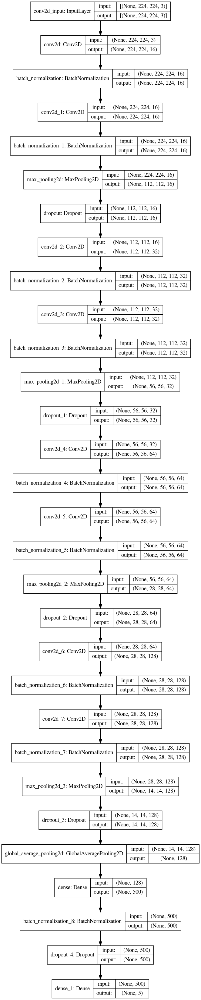

In [15]:
from keras.utils.vis_utils import plot_model
plot_model(model2, to_file='scratch_model2.png', show_shapes=True, show_layer_names=True)

In [16]:
from tensorflow.keras.optimizers import Adam
EPOCHS = 30

train_gen, val_gen = gen()
optm = Adam(lr=0.001)
model2.compile(loss='sparse_categorical_crossentropy', optimizer=optm, 
                  metrics=['accuracy'])

from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping   


EarlyStopping = EarlyStopping(monitor='val_loss',
                              min_delta=.0001,
                              patience=5,
                              verbose=1,
                              mode='auto',
                              baseline=None,
                              restore_best_weights=True)

model_save = ModelCheckpoint('./scratch_model2.h5',
                             save_best_only = True, 
                             save_weights_only = False,
                             monitor = 'val_loss', 
                             mode = 'min', verbose = 1)

history2 = model2.fit_generator(train_gen,
                              steps_per_epoch = train_gen.samples // BATCH_SIZE,
                              epochs = EPOCHS,
                              validation_data = val_gen,
                              validation_steps = val_gen.samples // BATCH_SIZE,
                              callbacks=[EarlyStopping, model_save])

Found 17117 validated image filenames belonging to 5 classes.
Found 4280 validated image filenames belonging to 5 classes.
Epoch 1/30
534/534 [==============================] - 498s 925ms/step - loss: 1.8454 - accuracy: 0.4220 - val_loss: 1.1051 - val_accuracy: 0.6243

Epoch 00001: val_loss improved from inf to 1.10510, saving model to ./scratch_model2.h5
Epoch 2/30
534/534 [==============================] - 359s 673ms/step - loss: 1.1873 - accuracy: 0.5948 - val_loss: 1.0622 - val_accuracy: 0.6292

Epoch 00002: val_loss improved from 1.10510 to 1.06217, saving model to ./scratch_model2.h5
Epoch 3/30
534/534 [==============================] - 360s 674ms/step - loss: 1.0405 - accuracy: 0.6295 - val_loss: 1.0802 - val_accuracy: 0.5599

Epoch 00003: val_loss did not improve from 1.06217
Epoch 4/30
534/534 [==============================] - 359s 673ms/step - loss: 0.9568 - accuracy: 0.6468 - val_loss: 0.9760 - val_accuracy: 0.6572

Epoch 00004: val_loss improved from 1.06217 to 0.97601, sa

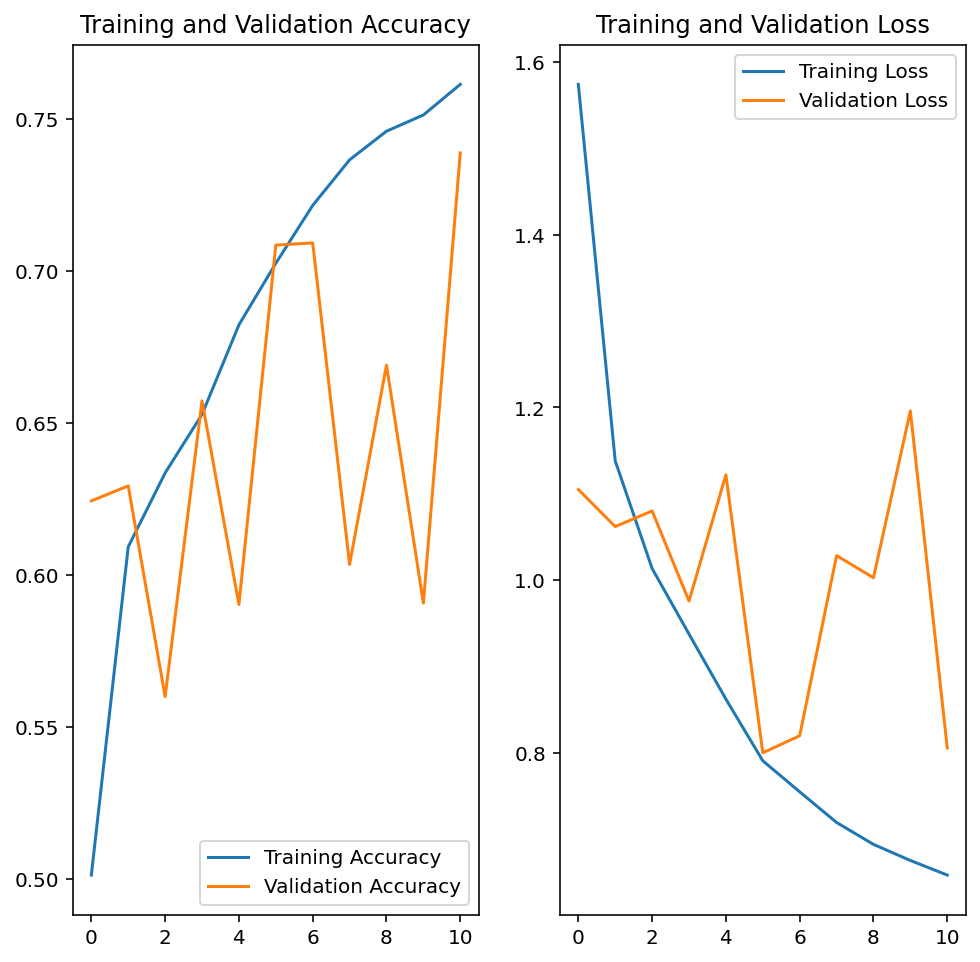

In [17]:
plot(history2)

In [19]:
print(history2.history["val_accuracy"][-6])
print(history2.history["val_loss"][-6])

0.7084116339683533
0.8003625869750977


In [21]:
test_images = os.listdir(test_path)    
for image in test_images:
    print(np.argmax(predict(os.path.join(test_path, image) , model2)))

3
